In [9]:
import matplotlib.pyplot as plt
%matplotlib inline
import torch
import torch.nn.functional as F

In [3]:
words = open('names.txt').read().splitlines()

In [4]:
chars = sorted(list(set([c for w in words for c in w])))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0

In [5]:
itos = {i:s for s,i in stoi.items()}

In [5]:
# Exercise 1: build a simple bigram model for next-character prediction
# - store the co-counts of each character in a 27x27 matrix N
# - compute the normalized probabilities into a matrix P
# - generate a bunch of samples from the model using P and torch.multinomial

In [6]:
N = torch.zeros((28,28), dtype=torch.int32)
for w in words:
    chs = ['.'] + list(w) + ['.']
    for ch1, ch2 in zip(chs, chs[1:]):
        ix1 = stoi[ch1]
        ix2 = stoi[ch2]
        N[ix1, ix2] += 1

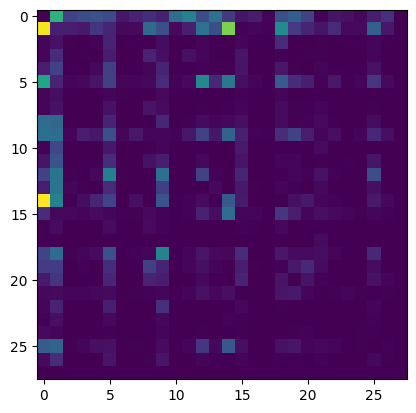

In [7]:

plt.imshow(N)

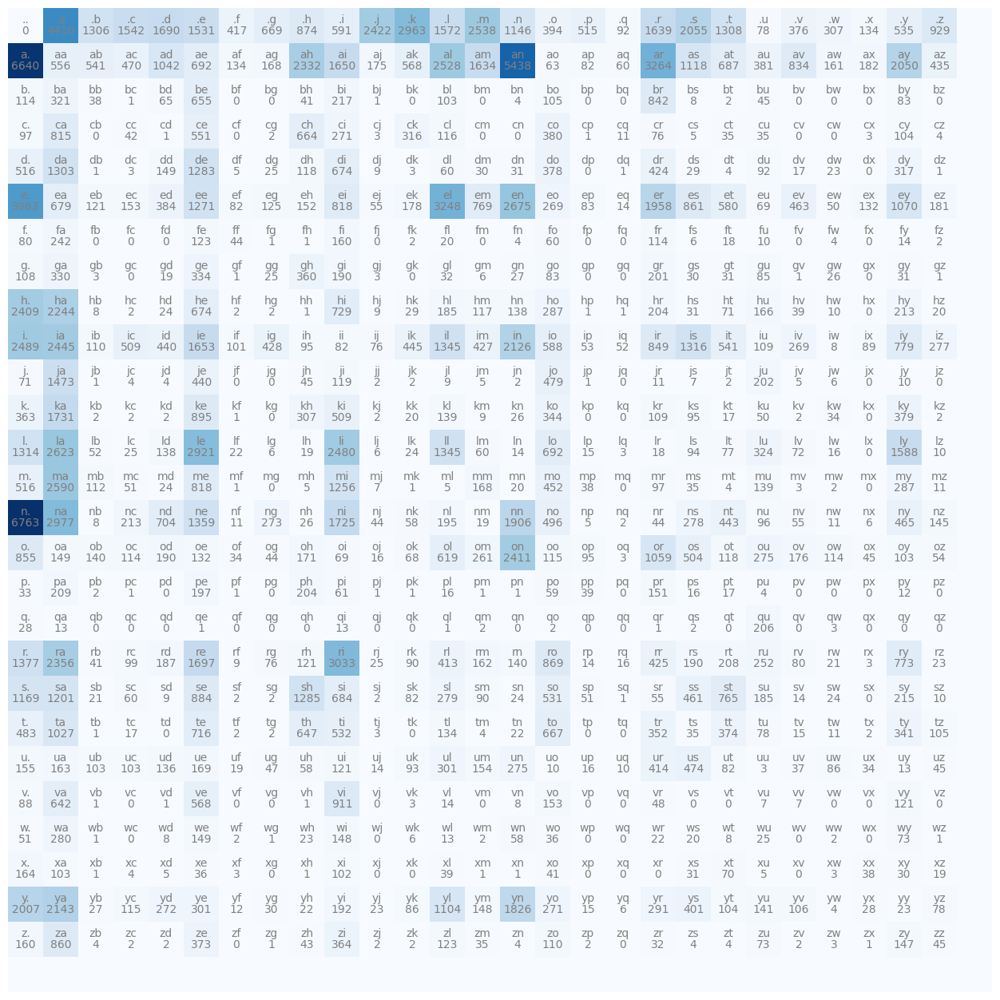

In [8]:
plt.figure(figsize=(16,16))
plt.imshow(N, cmap='Blues')
for i in range(27):
    for j in range(27):
        chstr = itos[i] + itos[j]
        plt.text(j, i, chstr, ha="center", va="bottom", color='gray')
        plt.text(j, i, N[i, j].item(), ha="center", va="top", color='gray')
plt.axis('off');

In [9]:
# useful to reproduce results
g = torch.Generator().manual_seed(2147483647)

In [10]:
P = N.float()
P = P / P.sum(1, keepdim=True)

In [11]:
g = torch.Generator().manual_seed(2147483647)
for _ in range(30):
    ix = 0
    out = []
    while True:
        p = P[ix]
        ix = torch.multinomial(p, num_samples=1, replacement=True, generator=g).item()
        out.append(itos[ix])
        if ix == 0:
            break
    print(''.join(out))

cava.
ayamaijowy.
aianeta.
rl.
miryndardyrioma.
kiinninaswila.
en.
ahlanyanlen.
tav.
sissth.
eygerinan.
sullyukrbrilahubrnidrianelkheyneligalah.
ka.
f.
elah.
m.
ri.
nil.
n.
diyn.
noldale.
aireri.
ryndareiiyash.
ahe.
l.
lioverene.
miri.
akharo.
lein.
han.


In [12]:
# Exercise 2: build the same bigram model using the NLL loss
# - the dataset is created and encoded for you
# - create the weights matrix W
# - build a training loop to minimize the NLL
# - sample from the model

In [35]:
# create a training set for bigram model
# 
xs = []
ys = []
for w in words:
    chs = ['.'] + list(w) + ['.']
    for ch1, ch2 in zip(chs, chs[1:]):
        ix1 = stoi[ch1]
        ix2 = stoi[ch2]
        xs.append(ix1)
        ys.append(ix2)
xs = torch.tensor(xs)
ys = torch.tensor(ys)
num = xs.nelement()

In [36]:
import torch.nn.functional as F

In [37]:
g = torch.Generator().manual_seed(2147483647)
W = torch.randn((27,27), generator=g)
W.requires_grad=True

In [38]:
for k in range(2000):
    #forward pass
    xenc = F.one_hot(xs, num_classes=27).float()
    logits = xenc @ W
    counts = logits.exp()
    probs = counts / counts.sum(1, keepdim=True)
    loss = -probs[torch.arange(num), ys].log().mean() + 0.01 * (W**2).mean()

    # backward pass
    W.grad = None
    loss.backward()

    # update
    lmbda = 50
    W.data += -lmbda * W.grad

    print(k, loss.item())

3.768618583679199
3.3788068294525146
3.161090850830078
3.0271859169006348
2.9344842433929443
2.867231607437134
2.8166542053222656
2.777146577835083
2.7452542781829834
2.7188305854797363
2.696505308151245
2.6773722171783447
2.6608052253723145
2.6463515758514404
2.633664846420288
2.622471570968628
2.6125476360321045
2.6037068367004395
2.595794916152954
2.5886807441711426
2.5822560787200928
2.5764293670654297
2.5711236000061035
2.566272735595703
2.5618226528167725
2.5577263832092285
2.5539441108703613
2.550442695617676
2.5471925735473633
2.5441696643829346
2.5413525104522705
2.538721799850464
2.536262273788452
2.5339579582214355
2.531797409057617
2.5297679901123047
2.527860164642334
2.5260636806488037
2.5243709087371826
2.522773265838623
2.521263837814331
2.519836664199829
2.5184857845306396
2.5172057151794434
2.515990734100342
2.5148372650146484
2.5137407779693604
2.51269793510437
2.511704921722412
2.5107581615448
2.509854793548584
2.5089921951293945
2.5081682205200195
2.507380247116089


In [39]:
# finally, sample from the neural net model
g = torch.Generator().manual_seed(2147483647)

for k in range(10):
    out = []
    ix = 0
    for _ in range(10):
        x = F.one_hot(torch.tensor([ix]), num_classes=27).float()
        logits = x @ W
        counts = logits.exp()
        probs = counts / counts.sum(1, keepdim=True)
        ix = probs.multinomial(num_samples=1, replacement=True, generator=g).item()
        if ix == 0:
            break
        out.append(itos[ix])
    print(''.join(out))

cexze
momasurail
azityha
konimittai
n
llayn
ka
da
staiyaubrt
bhrigotai


In [28]:
# Exercise 3: homework (*) extend the previous model to trigram

In [22]:
# create the dataset (trigram model)
xs, ys = [], []
for w in words:
  chs = ['.'] + list(w) + ['.']
  for ch1, ch2, ch3 in zip (chs, chs[1:], chs[2:]):
    #print(ch1,ch2,ch3)
    ix1 = stoi[ch1]
    ix2 = stoi[ch2]
    ix3 = stoi[ch3]
    xs.append([ix1,ix2])
    ys.append(ix3)
xs = torch.tensor(xs)
ys = torch.tensor(ys)
num = xs.shape[0]
print(f'num examples = {num}')

# initialize the network
g = torch.Generator().manual_seed(2147483647)
W = torch.rand(27, 27, 27, generator=g)
W.requires_grad = True

num examples = 196113


In [20]:
# split into train/dev/test
a = int(.8 * num)
b = int(.9 * num)
xs_train = xs[:a,:]
xs_dev = xs[a:b,:]
xs_test = xs[b:,:]
ys_train = ys[:a]
ys_dev = ys[a:b]
ys_test = ys[b:]
num_train = xs_train.shape[0]
num_dev = xs_dev.shape[0]
print(f'train samples = {num_train} / {num}')

train samples = 156890 / 196113


In [24]:
train_loss = []
dev_loss = []
lr = 1.0

# gradient descent
for k in range(2000):

  # forward pass
  xenc = F.one_hot(xs_train, num_classes=27).float()
  logits = torch.einsum('bik,kjl->bil', xenc, W)  # [bs, 2, 27]
  probs = F.softmax(logits, dim=2)
  probs = probs[torch.arange(0, num_train), :, ys_train]
  loss = - torch.mean(torch.log(probs))
  
  # backward pass
  W.grad = None
  loss.backward()

  # update
  W.data -= lr * W.grad

  print(k, loss.item())
  train_loss.append(loss.item())

  with torch.no_grad():
    if k % 100 == 0:
      # dev loss
      xenc = F.one_hot(xs_dev, num_classes=27).float()
      logits = torch.einsum('bik,kjl->bil', xenc, W)  # [bs, 2, 27]
      probs = F.softmax(logits, dim=2)
      probs = probs[torch.arange(0, num_dev), :, ys_dev]
      loss_dev = - torch.mean(torch.log(probs))
      print(f'\ttrain loss, dev loss = {loss.item()}, {loss_dev.item()}')
      train_loss.append(loss.item())
      dev_loss.append(loss_dev.item())

print("Mean of training loss: ", sum(train_loss)/len(train_loss))
print("Mean of dev set loss: ", sum(dev_loss)/len(dev_loss))
print("----------------------------")


0 4.235923767089844
	train loss, dev loss = 4.235923767089844, 3.959491729736328
1 3.9364631175994873
2 3.72186017036438
3 3.5554087162017822
4 3.427953004837036
5 3.3304433822631836
6 3.2538254261016846
7 3.191235065460205
8 3.1381332874298096
9 3.092017650604248
10 3.0515408515930176
11 3.0158486366271973
12 2.9842896461486816
13 2.956315755844116
14 2.931445598602295
15 2.9092586040496826
16 2.889389991760254
17 2.8715293407440186
18 2.855412244796753
19 2.8408124446868896
20 2.8275346755981445
21 2.8154067993164062
22 2.80427885055542
23 2.794018268585205
24 2.784510850906372
25 2.7756588459014893
26 2.767381191253662
27 2.759608745574951
28 2.7522871494293213
29 2.7453701496124268
30 2.7388193607330322
31 2.7326040267944336
32 2.7266969680786133
33 2.721076488494873
34 2.715721607208252
35 2.7106165885925293
36 2.705744504928589
37 2.70109224319458
38 2.6966464519500732
39 2.6923954486846924
40 2.6883292198181152
41 2.684436559677124
42 2.6807079315185547
43 2.677135705947876
44 2

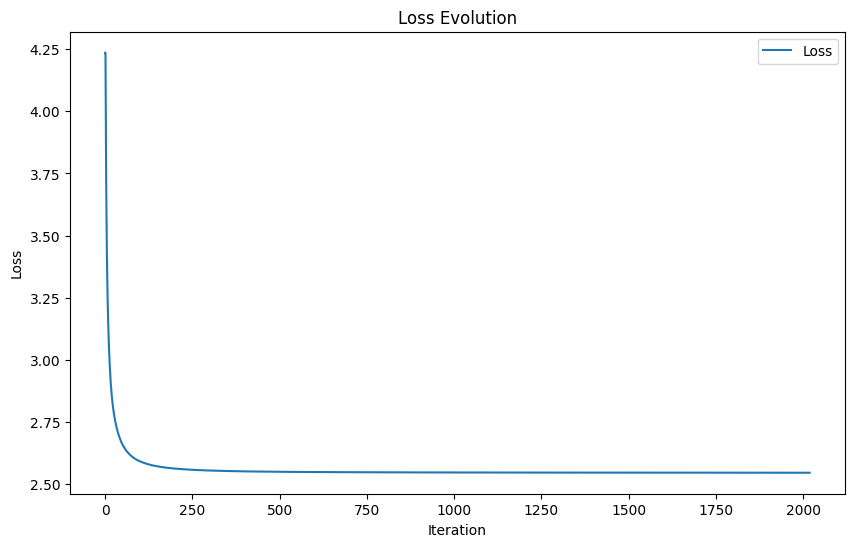

In [25]:
plt.figure(figsize=(10, 6))
plt.plot(train_loss, label='Loss')
plt.title('Loss Evolution')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [33]:
# finally, sample from the neural net model
import random
g = torch.Generator().manual_seed(2147483647)

## Sampling 
for k in range(10):
    out = []
    ix_1 = stoi['.']
    ix_2 = torch.randint(0, 26, (1,)).item()
    for _ in range(10):

        x = F.one_hot(torch.tensor([ix_1, ix_2]), num_classes=27).float()  
        logits = torch.einsum('ik,kjl->l', x, W)
        probs = F.softmax(logits, dim=0)
        ix_3 = torch.multinomial(probs, 1).item()

        out.append(itos[ix_2])

        if ix_3 == 0:
            break

        ix_1 = ix_2
        ix_2 = ix_3


    print(''.join(out))

jalla
ea
iaa
sy
na
tainn
fy
dai
vao
qais


In [17]:
# Exercise 4: let's build a better model
# Bengio et al. 2003 MLP language model paper, https://www.jmlr.org/papers/volume3/bengio03a/bengio03a.pdf

In [18]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
%matplotlib inline

In [19]:
block_size = 3
def build_dataset(words):
    X, Y = [], []
    for w in words:
        context = [0] * block_size
        for ch in w + '.':
            ix = stoi[ch]
            X.append(context)
            Y.append(ix)
            context = context[1:] + [ix]

    X = torch.tensor(X)
    Y = torch.tensor(Y)
    return X, Y

import random
random.seed(42)
random.shuffle(words)
n1 = int(0.8 * len(words))
n2 = int(0.9 * len(words))

X_train, Y_train = build_dataset(words[:n1])
X_dev, Y_dev = build_dataset(words[n1:n2])
X_test, Y_test = build_dataset(words[n2:])

In [20]:
emb_size = 200
g = torch.Generator().manual_seed(2147483647)
C = torch.randn((27,10))
W1 = torch.randn((30, emb_size))
b1 = torch.randn(emb_size)
W2 = torch.randn((emb_size, 27))
b2 = torch.randn((1, 27))
parameters = [C, W1, b1, W2, b2]
for p in parameters:
    p.requires_grad = True


In [21]:
# init weights
b1 = torch.nn.init.zeros_(b1)
b2 = torch.nn.init.zeros_(b2)
W1 = torch.nn.init.uniform_(W1)
W2 = torch.nn.init.uniform_(W2)

In [22]:
stepi = []
lossi = []
lri = []

In [23]:
for p in parameters:
    p.requires_grad = True

In [24]:
batch_size = 32
lr_ = 1
decay_rate_ = 1e-9
for i in range(200000):
    
    # minibatch
    ix = torch.randint(0, X_train.shape[0], (batch_size,))

    # forward pass
    emb = C[X_train[ix]]
    h = torch.tanh(emb.view(-1, 30) @ W1 + b1)
    logits = h @ W2 + b2
    loss = F.cross_entropy(logits, Y_train[ix])
    # backward pass
    for p in parameters:
        p.grad = None
    loss.backward()
    # update
    lr = 0.1 if i < 100000 else 0.01
    #lr_ = lr_ * (1/(1+decay_rate_ * i))
    for p in parameters:
        p.data += -lr * p.grad
    stepi.append(i)
    lossi.append(loss.log10().item())
    lri.append(lr_)
    print(i, loss)

0 tensor(8.0858, grad_fn=<NllLossBackward0>)
1 tensor(6.7661, grad_fn=<NllLossBackward0>)
2 tensor(6.1339, grad_fn=<NllLossBackward0>)
3 tensor(5.6995, grad_fn=<NllLossBackward0>)
4 tensor(5.0950, grad_fn=<NllLossBackward0>)
5 tensor(5.6620, grad_fn=<NllLossBackward0>)
6 tensor(4.6525, grad_fn=<NllLossBackward0>)
7 tensor(5.0928, grad_fn=<NllLossBackward0>)
8 tensor(4.2714, grad_fn=<NllLossBackward0>)
9 tensor(5.4770, grad_fn=<NllLossBackward0>)
10 tensor(5.9615, grad_fn=<NllLossBackward0>)
11 tensor(3.9156, grad_fn=<NllLossBackward0>)
12 tensor(4.1451, grad_fn=<NllLossBackward0>)
13 tensor(3.8612, grad_fn=<NllLossBackward0>)
14 tensor(4.7477, grad_fn=<NllLossBackward0>)
15 tensor(4.4959, grad_fn=<NllLossBackward0>)
16 tensor(4.0791, grad_fn=<NllLossBackward0>)
17 tensor(4.0200, grad_fn=<NllLossBackward0>)
18 tensor(4.6315, grad_fn=<NllLossBackward0>)
19 tensor(4.7198, grad_fn=<NllLossBackward0>)
20 tensor(3.6607, grad_fn=<NllLossBackward0>)
21 tensor(4.1627, grad_fn=<NllLossBackward0>

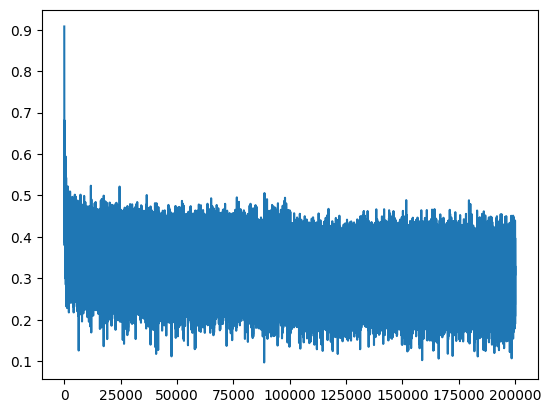

In [25]:
plt.plot(stepi, lossi)

In [26]:
# train and val loss
emb = C[X_dev]
h = torch.tanh(emb.view(-1, 30) @ W1 + b1)
logits = h @ W2 + b2
loss = F.cross_entropy(logits, Y_dev)
print(f'val loss = {loss}')

emb = C[X_train]
h = torch.tanh(emb.view(-1, 30) @ W1 + b1)
logits = h @ W2 + b2
loss = F.cross_entropy(logits, Y_train)
print(f'train loss = {loss}')


val loss = 2.110243558883667
train loss = 2.0498099327087402


In [28]:
# results (loss dev, loss train)
# no init, batch size 32, 200K steps, lr policy: lr = 0.1 if i < 100000 else 0.01, emb_size=200
2.15, 2.11
# **init uniform**, batch size 32, 200K steps, lr policy: lr = 0.1 if i < 100000 else 0.01, emb_size=200
2.16, 2.05
# init uniform, batch size 32, 200K steps, lr policy: lr = 0.1 if i < 100000 else 0.01, **emb_size=300**
2.10, 2.05
# init uniform, **batch size 2000**, 200K steps, lr policy: lr = 0.1 if i < 100000 else 0.01, emb_size=300
2.11, 2.01
# init uniform, **batch size 2000**, 200K steps, lr policy: lr_ = lr_ * (1/(1+decay_rate_ * i)), decay_rate = 1E-9, emb_size=300
2.11, 1.98

(2.11, 1.98)

In [27]:
# sample from the model
g = torch.Generator().manual_seed(2147483647 + 4)

for _ in range(20):
    
    out = []
    context = [0] * block_size # initialize with all ...
    while True:
      emb = C[torch.tensor([context])] # (1,block_size,d)
      h = torch.tanh(emb.view(1, -1) @ W1 + b1)
      logits = h @ W2 + b2
      probs = F.softmax(logits, dim=1)
      ix = torch.multinomial(probs, num_samples=1, generator=g).item()
      context = context[1:] + [ix]
      out.append(ix)
      if ix == 0:
        break
    
    print(''.join(itos[i] for i in out))

garrioni.
cort.
nilin.
ash.
legaal.
grayleigh.
prob.
azal.
kais.
evradi.
elig.
cos.
calice.
dabaet.
elow.
aziyan.
brayla.
riter.
bardanell.
zaily.


In [77]:
# Exercise 5 homework (*): add batchnorm to your network and report the results
# Batch norm is added between the linear layer and the non-linearity
# How many parameters does this add to your network?

In [111]:
emb_size = 200
g = torch.Generator().manual_seed(2147483647)
C = torch.randn((27,10))
W1 = torch.randn((30, emb_size))
b1 = torch.randn(emb_size)
W2 = torch.randn((emb_size, 27))
b2 = torch.randn((1, 27))

bngains = torch.ones((1, emb_size))
bnbias = torch.zeros((1, emb_size))
bnmean_running = torch.zeros((1, emb_size))
bnstd_running = torch.ones((1, emb_size))

parameters = [C, W1, b1, W2, b2, bngains, bnbias]
for p in parameters:
    p.requires_grad = True

In [112]:
# init weights
b1 = torch.nn.init.zeros_(b1)
b2 = torch.nn.init.zeros_(b2)
W1 = torch.nn.init.uniform_(W1)
W2 = torch.nn.init.uniform_(W2)

In [113]:
stepi = []
lossi = []
lri = []

In [114]:
batch_size = 32

for i in range(200000):
    
    # minibatch
    ix = torch.randint(0, X_train.shape[0], (batch_size,))

    # forward pass
    emb = C[X_train[ix]]
    hpreact = emb.view(-1, 30) @ W1 + b1

    # add batch norm
    bnmean = hpreact.mean(axis=0, keepdim=True)
    bnstdev = hpreact.std(axis=0, keepdim=True)
    hpreact = bngains * (hpreact - bnmean) / bnstdev + bnbias
    with torch.no_grad():
        bnmean_running = 0.999 * bnmean_running + 0.001 * bnmean
        bnstd_running = 0.999 * bnstd_running + 0.001 * bnstdev

    h = torch.tanh(hpreact)
    logits = h @ W2 + b2
    loss = F.cross_entropy(logits, Y_train[ix])
    
    # backward pass
    for p in parameters:
        p.grad = None
    loss.backward()
    # update
    lr = 0.1 if i < 100000 else 0.01
    #lr_ = lr_ * (1/(1+decay_rate_ * i))
    for p in parameters:
        p.data += -lr * p.grad
    stepi.append(i)
    lossi.append(loss.log10().item())
    lri.append(lr_)
    print(i, loss)

0 tensor(6.1888, grad_fn=<NllLossBackward0>)
1 tensor(5.0237, grad_fn=<NllLossBackward0>)
2 tensor(5.0307, grad_fn=<NllLossBackward0>)
3 tensor(3.8504, grad_fn=<NllLossBackward0>)
4 tensor(3.6480, grad_fn=<NllLossBackward0>)
5 tensor(3.8631, grad_fn=<NllLossBackward0>)
6 tensor(3.4555, grad_fn=<NllLossBackward0>)
7 tensor(3.6968, grad_fn=<NllLossBackward0>)
8 tensor(3.3887, grad_fn=<NllLossBackward0>)
9 tensor(3.5581, grad_fn=<NllLossBackward0>)
10 tensor(3.2938, grad_fn=<NllLossBackward0>)
11 tensor(3.5047, grad_fn=<NllLossBackward0>)
12 tensor(3.3612, grad_fn=<NllLossBackward0>)
13 tensor(3.2901, grad_fn=<NllLossBackward0>)
14 tensor(3.1198, grad_fn=<NllLossBackward0>)
15 tensor(2.8326, grad_fn=<NllLossBackward0>)
16 tensor(3.6037, grad_fn=<NllLossBackward0>)
17 tensor(3.2350, grad_fn=<NllLossBackward0>)
18 tensor(3.2973, grad_fn=<NllLossBackward0>)
19 tensor(3.1415, grad_fn=<NllLossBackward0>)
20 tensor(3.3084, grad_fn=<NllLossBackward0>)
21 tensor(3.4967, grad_fn=<NllLossBackward0>

In [115]:
# recompute means and bias over entire training set
with torch.no_grad():
    emb = C[X_train]
    emb = emb.view(-1, 30)
    hpreact = emb @ W1 + b1
    bnmean = hpreact.mean(axis=0, keepdim=True)
    bnstdev = hpreact.std(axis=0, keepdim=True)

In [116]:
# train and val loss 
# without batch norm: val = 2.11, train = 2.05
with torch.no_grad():
    emb = C[X_dev]
    emb = emb.view(-1, 30)
    hpreact = emb @ W1 + b1
    hpreact = bngains * (hpreact - bnmean) / bnstdev + bnbias
    h = torch.tanh(hpreact)
    logits = h @ W2 + b2
    loss = F.cross_entropy(logits, Y_dev)
    print(f'val loss = {loss}')

    emb = C[X_train]
    emb = emb.view(-1, 30)
    hpreact = emb @ W1 + b1
    hpreact = bngains * (hpreact - bnmean) / bnstdev + bnbias
    h = torch.tanh(hpreact)
    logits = h @ W2 + b2
    loss = F.cross_entropy(logits, Y_train)
    print(f'train loss = {loss}')

val loss = 2.1449708938598633
train loss = 2.122518301010132


In [118]:
# sample from the model
g = torch.Generator().manual_seed(2147483647 + 4)

for _ in range(20):
    
    out = []
    context = [0] * block_size # initialize with all ...
    while True:
      emb = C[torch.tensor([context])] # (1,block_size,d)
      emb = emb.view(-1, 30)
      hpreact = emb @ W1 + b1
      hpreact = bngains * (hpreact - bnmean) / bnstdev + bnbias
      h = torch.tanh(hpreact)
      logits = h @ W2 + b2
      probs = F.softmax(logits, dim=1)
      ix = torch.multinomial(probs, num_samples=1, generator=g).item()
      context = context[1:] + [ix]
      out.append(ix)
      if ix == 0:
        break
    
    print(''.join(itos[i] for i in out))

garri.
yah.
wal.
nia.
nuasa.
legaarlon.
die.
alis.
joda.
ana.
aiz.
eva.
darlen.
aitz.
caliee.
dabaet.
elyn.
aziyan.
brayla.
riter.
